# WATER PUMP FUNCTIONALITY CLASSIFICATION IN TANZANIA

### INTRODUCTION


Access to water is a fundamental human right, yet many developing countries are struggling with unreliable water infrastructure like in the case of Tanzania, where many of the country's water pumps are either non-functional or need repair. Therefore, predictions of the status of these pumps can help the country's government and NGOs prioritize maintenance efforts. 

This Project aims to develop a classification model that predicts the status of the water pumps. They status(target) categories are:

> a) **Functional** : The pump is working correctly.

> b) **Non-Functional** : The pump is not working.

> c) **Functional but need repair** : The pump is working but requires 

### BUSINESS UNDERSTANDING

#### Problem statement
Many of the water pumps in Tanzania are not functional or need repair. On ground inspections of the pumps is quite time consuming and costly.A model that predicts the status of the pumps would come in handy by:

> a) **Reducing inspection costs** by only inspecting pumps likely to be faulty

> b) **Improving maintainance efficiency** by identifying pumps that need maintainance

> c) **Enhance water accessibility** by fixing likely faulty pumps

### Stakeholders
> 1. The Tanzanian Gorvenment

> 2. Non-Gorvernmental Organizations(NGOs)


### DATA UNDERSTANDING

The dataset is from **DrivenData's'Pump it Up'competition**.It conrains information about water pumps across Tanzania. The dataset comprises of more that 40 features describing the pump characteristics.


The training dataset contains 59,400 waterpoints in Tanzania and the following 39 features:


| Column           | Description                                                                                       |
|------------------|---------------------------------------------------------------------------------------------------|
| amount_tsh       | Total static head (amount water available to waterpoint)                                      |
| date_recorded    | Date on which the row was recorded                                                       |
| price            | Individual or organization that funded installation of the well                                   |
| gps_height       | The altitude at which the water pump is located                                                   |
| installer        | Individual or organization that installed the well                                                |
| longitude        | Longitude coordinates of the water point                                                          |
| latitude         | Latitude coordinates of the water point                                                           |
| wpt_name         | Name of the waterpoint if there is one                                                            |
| num_private      | Information about this feature is unavailable                                                     |
| basin            | Name of the geographic water basin                  |
| subvillage       | Geographic location                                                                    |
| region           | Geographic location                     |
| region_code      | Coded geographic location                                              |
| district_code    | Coded geographic location                                                                    |
| lga              | Geographic location                                                                          |
| ward             | Geographic location                       |
| population       | Population around the well                                                                     |
| public_meeting   | Boolean data whether public meeting for the water pump was conducted                              |
| recorded_by      | Name of agency which recorded the water pump data                                                 |
| scheme_management| Name of scheme that manages the waterpoint                    |
| scheme_name      | Name of scheme under which the water point was established                                       |
| permit           | Boolean data describing whether the water point has permit available or not                  |
| contruction_year | Year in which the water point was constructed                                             |
| extraction_type  | The kind of extraction the waterpoint uses                       |
| extraction_type_group        | The kind of extraction the waterpoint uses                               |
| extraction_type_class      | The kind of extraction the waterpoint uses                                            |
| management       | Name of organization/authority that manages the water point                    |
| managememt_group | Category of organization/authority that manages the water point                       |
| payment          | Describes how residents pay for water                                       |
| payment_type     | Describes how residents pay for water                  |
| water_quality    | The quality of water                                                                    |
| quality_group    | The quality of water                     |
| quantity         | The quantity of water                                               |
| quantity_group   | The quantity of water                                                                    |
| source           | The source of water                                                                          |
| source_type      | The source of water                       |
| source_class     | The source of water                                                                     |
| waterpoint_type  | The nature of water point                           |
| waterpoint_type_group  | The nature of water point                        |  



> 1. **Data Exploration**

In [151]:
# Import necessary modules
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import confusion_matrix, accuracy_score, f1_score, precision_score, recall_score
from sklearn.model_selection import GridSearchCV
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import ConfusionMatrixDisplay, classification_report
from sklearn.metrics import roc_curve, auc, roc_auc_score
from imblearn.over_sampling import SMOTE
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
# Set random seed for reproducibility

In [68]:
# Load the dataset
x_train = pd.read_csv('./Data/x_train.csv')
y_train = pd.read_csv('./Data/y_train.csv')

# Merge features and target variable
Pump_Data_Train = pd.concat([x_train, y_train], axis=1)

# Display the first five rows of the dataset

Pump_Data_Train.head()

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,...,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,id,status_group
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,...,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,69572,functional
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,...,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,8776,functional
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,...,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,34310,functional
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,...,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,67743,non functional
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,...,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,19728,functional


In [69]:
# Check for Shape of the dataset
Pump_Data_Train.shape

(59400, 42)

In [70]:
# Check information about the dataset
Pump_Data_Train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59400 entries, 0 to 59399
Data columns (total 42 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     59400 non-null  int64  
 1   amount_tsh             59400 non-null  float64
 2   date_recorded          59400 non-null  object 
 3   funder                 55765 non-null  object 
 4   gps_height             59400 non-null  int64  
 5   installer              55745 non-null  object 
 6   longitude              59400 non-null  float64
 7   latitude               59400 non-null  float64
 8   wpt_name               59400 non-null  object 
 9   num_private            59400 non-null  int64  
 10  basin                  59400 non-null  object 
 11  subvillage             59029 non-null  object 
 12  region                 59400 non-null  object 
 13  region_code            59400 non-null  int64  
 14  district_code          59400 non-null  int64  
 15  lg

### DATA PREPARATION

> 1. **Data Cleaning**

In [71]:
# Check for missing values
Pump_Data_Train.isnull().sum()

id                           0
amount_tsh                   0
date_recorded                0
funder                    3635
gps_height                   0
installer                 3655
longitude                    0
latitude                     0
wpt_name                     0
num_private                  0
basin                        0
subvillage                 371
region                       0
region_code                  0
district_code                0
lga                          0
ward                         0
population                   0
public_meeting            3334
recorded_by                  0
scheme_management         3877
scheme_name              28166
permit                    3056
construction_year            0
extraction_type              0
extraction_type_group        0
extraction_type_class        0
management                   0
management_group             0
payment                      0
payment_type                 0
water_quality                0
quality_

In [72]:
# Replace blank values with NaN
Pump_Data_Train.replace('', np.nan, inplace=True)


In [73]:
# Fill missing values for categorical columns
categorical_cols = ['funder', 'installer', 'scheme_management', 'scheme_name' , 'subvillage']

# Using "Unknown" for high-cardinality columns or mode() for common ones:
for col in categorical_cols:
    if Pump_Data_Train[col].mode().empty:
        Pump_Data_Train[col] = Pump_Data_Train[col].fillna("Unknown")
    else:
        Pump_Data_Train[col] = Pump_Data_Train[col].fillna(Pump_Data_Train[col].mode()[0])
        
# Fill missing values for Boolean columns
bool_cols = ['public_meeting', 'permit']

# Convert to boolean 
Pump_Data_Train[bool_cols] = Pump_Data_Train[bool_cols].astype('boolean')

# Fill missing values for boolean columns 
for col in bool_cols:
    Pump_Data_Train[col] = Pump_Data_Train[col].fillna(Pump_Data_Train[col].mode()[0])

# CHeck for missing values again
Pump_Data_Train.isnull().sum()

id                       0
amount_tsh               0
date_recorded            0
funder                   0
gps_height               0
installer                0
longitude                0
latitude                 0
wpt_name                 0
num_private              0
basin                    0
subvillage               0
region                   0
region_code              0
district_code            0
lga                      0
ward                     0
population               0
public_meeting           0
recorded_by              0
scheme_management        0
scheme_name              0
permit                   0
construction_year        0
extraction_type          0
extraction_type_group    0
extraction_type_class    0
management               0
management_group         0
payment                  0
payment_type             0
water_quality            0
quality_group            0
quantity                 0
quantity_group           0
source                   0
source_type              0
s

In [74]:
# check shape of the dataset after filling missing values
Pump_Data_Train.shape

(59400, 42)

In [75]:
# Check for duplicate rows
Pump_Data_Train.duplicated().sum()

0

In [76]:
Pump_Data_Train['construction_year'].value_counts().sum()

59400

In [77]:
# Replace zeros in 'construction_year' with the NaN
Pump_Data_Train['construction_year'] = Pump_Data_Train['construction_year'].replace(0, np.nan)

In [78]:
# Check for zeros in 'construction_year'
Pump_Data_Train['construction_year'].value_counts()

2010.0    2645
2008.0    2613
2009.0    2533
2000.0    2091
2007.0    1587
2006.0    1471
2003.0    1286
2011.0    1256
2004.0    1123
2012.0    1084
2002.0    1075
1978.0    1037
1995.0    1014
2005.0    1011
1999.0     979
1998.0     966
1990.0     954
1985.0     945
1996.0     811
1980.0     811
1984.0     779
1982.0     744
1994.0     738
1972.0     708
1974.0     676
1997.0     644
1992.0     640
1993.0     608
2001.0     540
1988.0     521
1983.0     488
1975.0     437
1986.0     434
1976.0     414
1970.0     411
1991.0     324
1989.0     316
1987.0     302
1981.0     238
1977.0     202
1979.0     192
1973.0     184
2013.0     176
1971.0     145
1960.0     102
1967.0      88
1963.0      85
1968.0      77
1969.0      59
1964.0      40
1962.0      30
1961.0      21
1965.0      19
1966.0      17
Name: construction_year, dtype: int64

In [79]:
#Assign median construction year by region
Pump_Data_Train['construction_year'] = Pump_Data_Train.groupby('region')['construction_year'].transform(
                                        lambda x: x.fillna(x.median()))

c:\Users\JUDAH\Anaconda3\envs\learn-env\lib\site-packages\numpy\lib\nanfunctions.py:1113: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


In [80]:
# Assign overall median construction year
overall_median = Pump_Data_Train['construction_year'].median()
Pump_Data_Train['construction_year'] = Pump_Data_Train['construction_year'].fillna(overall_median)


In [81]:
# Fill missing values in 'construction_year' with the median
Pump_Data_Train['construction_year'].value_counts()

2000.0    14603
2005.0     5829
1996.0     3652
2010.0     2645
2008.0     2613
2009.0     2533
2007.0     1763
2006.0     1471
2003.0     1286
2011.0     1256
2004.0     1136
2002.0     1110
2012.0     1084
1978.0     1037
1995.0     1014
1998.0      983
1999.0      979
1990.0      954
1985.0      945
1980.0      811
1997.0      791
1984.0      779
1982.0      744
1994.0      738
1972.0      708
1974.0      676
1992.0      640
1988.0      610
1993.0      608
2001.0      601
1983.0      488
1975.0      437
1986.0      434
1976.0      414
1970.0      411
1991.0      324
1989.0      316
1987.0      302
1981.0      238
1977.0      202
1979.0      192
1973.0      184
2013.0      176
1971.0      145
1960.0      102
1967.0       88
1963.0       85
1968.0       77
1969.0       59
1964.0       40
1962.0       30
1961.0       21
1965.0       19
1966.0       17
Name: construction_year, dtype: int64

Below is how I checked for columns to drop in the dataset

In [82]:
# management group are categories for management
Pump_Data_Train[['management_group', 'management']].value_counts()

management_group  management      
user-group        vwc                 40507
                  wug                  6515
                  water board          2933
                  wua                  2535
commercial        private operator     1971
parastatal        parastatal           1768
commercial        water authority       904
other             other                 844
commercial        company               685
unknown           unknown               561
other             other - school         99
commercial        trust                  78
dtype: int64

In [83]:
# 'water_quality' and 'quality_group' are near duplicates
Pump_Data_Train[['water_quality', 'quality_group']].value_counts()

water_quality       quality_group
soft                good             50818
salty               salty             4856
unknown             unknown           1876
milky               milky              804
coloured            colored            490
salty abandoned     salty              339
fluoride            fluoride           200
fluoride abandoned  fluoride            17
dtype: int64

In [84]:
# 'quantity' and 'quantity_group' are duplicates
Pump_Data_Train[['quantity', 'quantity_group']].value_counts()

quantity      quantity_group
enough        enough            33186
insufficient  insufficient      15129
dry           dry                6246
seasonal      seasonal           4050
unknown       unknown             789
dtype: int64

In [85]:
# 'source_type' and 'source' are near duplicates
Pump_Data_Train[['source_type', 'source']].value_counts()

source_type           source              
spring                spring                  17021
shallow well          shallow well            16824
borehole              machine dbh             11075
river/lake            river                    9612
rainwater harvesting  rainwater harvesting     2295
borehole              hand dtw                  874
river/lake            lake                      765
dam                   dam                       656
other                 other                     212
                      unknown                    66
dtype: int64

In [86]:
# 'source_class' is a category for 'source_type' and 'source'
Pump_Data_Train[['source_class', 'source_type', 'source']].value_counts()

source_class  source_type           source              
groundwater   spring                spring                  17021
              shallow well          shallow well            16824
              borehole              machine dbh             11075
surface       river/lake            river                    9612
              rainwater harvesting  rainwater harvesting     2295
groundwater   borehole              hand dtw                  874
surface       river/lake            lake                      765
              dam                   dam                       656
unknown       other                 other                     212
                                    unknown                    66
dtype: int64

In [87]:
# 'waterpoint_type' and 'waterpoint_type_group' are duplicates
Pump_Data_Train[['waterpoint_type', 'waterpoint_type_group']].value_counts()

waterpoint_type              waterpoint_type_group
communal standpipe           communal standpipe       28522
hand pump                    hand pump                17488
other                        other                     6380
communal standpipe multiple  communal standpipe        6103
improved spring              improved spring            784
cattle trough                cattle trough              116
dam                          dam                          7
dtype: int64

As we can see, some column pairs—like a region and region code—have redundant information, making them collinear. Some columns are useless for modeling because they include an excessive number of unique values or the same value.

The list of categorical columns I will be removing, along with the justification for doing so, is provided here:

1.) Date of Recorded: __date__ >This is not required to forecast well functionality because it is a construction year. 

2.) __funder__ > 11,307 rows contain values that match those in the __installer__ column, while numerous other rows simply contain the same information spelled differently. Since the installer has a greater impact on a well's operation, I will remove the __funder__ column in order to prevent the multicollinearity effect.

3.) __wpt_name__ > Too many distinct values

4.) __subvillage__ >  The region can be used to represent it.

5.) __lga__ > The region can be used to represent it.

6.) __ward__ > The region can be used to represent it.

7.)__recorded_by__ >  For every row, its value is the same.

8.)__scheme_name__ >  Too many nulls and unique values

9.) __extraction_type__ > too similar to the extraction type class

10.)__extraction_type_group__ > 10. too similar to the extraction type class

11.)__management__ >  Since management_groups are management categories, I shall omit management.

12.) __payment__ > Since payment and payment_type are identical, I will remove payment.

13.)__quality_group__ >  connected with the quality of the water. Since there are distinct rows that must be dropped, I will maintain the water quality.

14.) __quantity__ > I will drop quantity because quantity_group are categories of quantity.




Here is a list of the numerical columns that I will drop, along with the reason for dropping.

1.) __num_private__ > no description has been given for this column and close to 99% are 0 values; this is likely not useful for modelling.

2.) __region_code__ > a duplicate of region.

3.) __district_code__ > it can be represented by the region.<br>

In [88]:
#Drop irrelevant columns
cols_to_drop = ['id', 'recorded_by', 'ward', 'recorded_by','wpt_name', 'quality_group','region_code', 'district_code','source_type', 'source',
                'scheme_name', 'subvillage','funder', 'num_private','quantity' , 'payment', 'management','extraction_type', 'extraction_type_group' ,'waterpoint_type']
Pump_Data_Train.drop(columns=cols_to_drop, inplace=True)


In [89]:
# Check the shape of the dataset after dropping columns
Pump_Data_Train.shape

(59400, 22)

In [90]:
#Check for top 10 rows of the dataset
Pump_Data_Train.head(10)

,amount_tsh,date_recorded,gps_height,installer,longitude,latitude,basin,region,lga,population,...,permit,construction_year,extraction_type_class,management_group,payment_type,water_quality,quantity_group,source_class,waterpoint_type_group,status_group
0,6000.0,2011-03-14,1390,Roman,34.938093,-9.856322,Lake Nyasa,Iringa,Ludewa,109,...,False,1999.0,gravity,user-group,annually,soft,enough,groundwater,communal standpipe,functional
1,0.0,2013-03-06,1399,GRUMETI,34.698766,-2.147466,Lake Victoria,Mara,Serengeti,280,...,True,2010.0,gravity,user-group,never pay,soft,insufficient,surface,communal standpipe,functional
2,25.0,2013-02-25,686,World vision,37.460664,-3.821329,Pangani,Manyara,Simanjiro,250,...,True,2009.0,gravity,user-group,per bucket,soft,enough,surface,communal standpipe,functional
3,0.0,2013-01-28,263,UNICEF,38.486161,-11.155298,Ruvuma / Southern Coast,Mtwara,Nanyumbu,58,...,True,1986.0,submersible,user-group,never pay,soft,dry,groundwater,communal standpipe,non functional
4,0.0,2011-07-13,0,Artisan,31.130847,-1.825359,Lake Victoria,Kagera,Karagwe,0,...,True,2000.0,gravity,other,never pay,soft,seasonal,surface,communal standpipe,functional
5,20.0,2011-03-13,0,DWE,39.172796,-4.765587,Pangani,Tanga,Mkinga,1,...,True,2009.0,submersible,user-group,per bucket,salty,enough,unknown,communal standpipe,functional
6,0.0,2012-10-01,0,DWSP,33.362410,-3.766365,Internal,Shinyanga,Shinyanga Rural,0,...,True,2005.0,handpump,user-group,never pay,soft,enough,groundwater,hand pump,non functional
7,0.0,2012-10-09,0,DWE,32.620617,-4.226198,Lake Tanganyika,Shinyanga,Kahama,0,...,True,2005.0,handpump,user-group,unknown,milky,enough,groundwater,hand pump,non functional
8,0.0,2012-11-03,0,Water Aid,32.711100,-5.146712,Lake Tanganyika,Tabora,Tabora Urban,0,...,True,2000.0,handpump,user-group,never pay,salty,seasonal,groundwater,hand pump,non functional
9,0.0,2011-08-03,0,Artisan,30.626991,-1.257051,Lake Victoria,Kagera,Karagwe,0,...,True,2000.0,handpump,user-group,never pay,soft,enough,groundwater,hand pump,functional


In [91]:
# Feature Engineer Age of the pump(from construction year to recorded year)
Pump_Data_Train['date_recorded'] = pd.to_datetime(Pump_Data_Train['date_recorded'])
Pump_Data_Train['recorded_year'] = Pump_Data_Train['date_recorded'].dt.year
Pump_Data_Train['age'] = Pump_Data_Train['recorded_year'] - Pump_Data_Train['construction_year']

# Drop original date columns
Pump_Data_Train.drop(['date_recorded', 'recorded_year', 'construction_year'], axis=1, inplace=True)


In [92]:
Pump_Data_Train.head(10)

,amount_tsh,gps_height,installer,longitude,latitude,basin,region,lga,population,public_meeting,...,permit,extraction_type_class,management_group,payment_type,water_quality,quantity_group,source_class,waterpoint_type_group,status_group,age
0,6000.0,1390,Roman,34.938093,-9.856322,Lake Nyasa,Iringa,Ludewa,109,True,...,False,gravity,user-group,annually,soft,enough,groundwater,communal standpipe,functional,12.0
1,0.0,1399,GRUMETI,34.698766,-2.147466,Lake Victoria,Mara,Serengeti,280,True,...,True,gravity,user-group,never pay,soft,insufficient,surface,communal standpipe,functional,3.0
2,25.0,686,World vision,37.460664,-3.821329,Pangani,Manyara,Simanjiro,250,True,...,True,gravity,user-group,per bucket,soft,enough,surface,communal standpipe,functional,4.0
3,0.0,263,UNICEF,38.486161,-11.155298,Ruvuma / Southern Coast,Mtwara,Nanyumbu,58,True,...,True,submersible,user-group,never pay,soft,dry,groundwater,communal standpipe,non functional,27.0
4,0.0,0,Artisan,31.130847,-1.825359,Lake Victoria,Kagera,Karagwe,0,True,...,True,gravity,other,never pay,soft,seasonal,surface,communal standpipe,functional,11.0
5,20.0,0,DWE,39.172796,-4.765587,Pangani,Tanga,Mkinga,1,True,...,True,submersible,user-group,per bucket,salty,enough,unknown,communal standpipe,functional,2.0
6,0.0,0,DWSP,33.362410,-3.766365,Internal,Shinyanga,Shinyanga Rural,0,True,...,True,handpump,user-group,never pay,soft,enough,groundwater,hand pump,non functional,7.0
7,0.0,0,DWE,32.620617,-4.226198,Lake Tanganyika,Shinyanga,Kahama,0,True,...,True,handpump,user-group,unknown,milky,enough,groundwater,hand pump,non functional,7.0
8,0.0,0,Water Aid,32.711100,-5.146712,Lake Tanganyika,Tabora,Tabora Urban,0,True,...,True,handpump,user-group,never pay,salty,seasonal,groundwater,hand pump,non functional,12.0
9,0.0,0,Artisan,30.626991,-1.257051,Lake Victoria,Kagera,Karagwe,0,True,...,True,handpump,user-group,never pay,soft,enough,groundwater,hand pump,functional,11.0


In [93]:
# Check the number of unique values in each column
Pump_Data_Train.nunique()

amount_tsh                  98
gps_height                2428
installer                 2145
longitude                57516
latitude                 57517
basin                        9
region                      21
lga                        125
population                1049
public_meeting               2
scheme_management           12
permit                       2
extraction_type_class        7
management_group             5
payment_type                 7
water_quality                8
quantity_group               5
source_class                 3
waterpoint_type_group        6
status_group                 3
age                         60
dtype: int64

The __installer__ column has too many unique values but an exploration shows that majority of these values are different spellings of the same value. I will, therefore, replace the different spellings with an appropriate spelling.

In [94]:
# Print top 20 values in installer column
Pump_Data_Train['installer'].value_counts().head(20)

DWE                   21057
Government             1825
RWE                    1206
Commu                  1060
DANIDA                 1050
KKKT                    898
Hesawa                  840
0                       777
TCRS                    707
Central government      622
CES                     610
Community               553
DANID                   552
District Council        551
HESAWA                  539
LGA                     408
World vision            408
WEDECO                  397
TASAF                   396
District council        392
Name: installer, dtype: int64

In [95]:
# Replace close variations and misspellings in the installer column

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('Central government', 'Tanzania Government',
                                          'Cental Government','Tanzania government','Cebtral Government', 
                                          'Centra Government', 'central government', 'CENTRAL GOVERNMENT', 
                                          'TANZANIA GOVERNMENT', 'TANZANIAN GOVERNMENT', 'Central govt', 
                                          'Centr', 'Centra govt', 'Tanzanian Government', 'Tanzania', 
                                          'Tanz', 'Tanza', 'GOVERNMENT', 
                                          'GOVER', 'GOVERNME', 'GOVERM', 'GOVERN', 'Gover', 'Gove', 
                                          'Governme', 'Governmen', 'Got', 'Serikali', 'Serikari', 'Government',
                                          'Central Government'), 
                                          value = 'Central Government')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('IDARA', 'Idara ya maji', 'MINISTRY OF WATER',
                                          'Ministry of water', 'Ministry of water engineer', 'MINISTRYOF WATER', 
                                          'MWE &', 'MWE', 'Wizara ya maji', 'WIZARA', 'wizara ya maji',
                                          'Ministry of Water'), 
                                          value ='Ministry of Water')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('District COUNCIL', 'DISTRICT COUNCIL',
                                          'Counc','District council','District Counci', 
                                          'Council', 'COUN', 'Distri', 'Halmashauri ya wilaya',
                                          'Halmashauri wilaya', 'District Council'), 
                                          value = 'District  Council')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('District water depar', 'District Water Department', 
                                          'District water department', 'Distric Water Department'),
                                          value = 'District Water Department')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('villigers', 'villager', 'villagers', 'Villa', 'Village',
                                          'Villi', 'Village Council', 'Village Counil', 'Villages', 'Vill', 
                                          'Village community', 'Villaers', 'Village Community', 'Villag',
                                          'Villege Council', 'Village council', 'Villege Council', 'Villagerd', 
                                          'Villager', 'VILLAGER', 'Villagers',  'Villagerd', 'Village Technician', 
                                          'Village water attendant', 'Village Office', 'VILLAGE COUNCIL',
                                          'VILLAGE COUNCIL .ODA', 'VILLAGE COUNCIL Orpha', 'Village community members', 
                                          'VILLAG', 'VILLAGE', 'Village Government', 'Village government', 
                                          'Village Govt', 'Village govt', 'VILLAGERS', 'VILLAGE WATER COMMISSION',
                                          'Village water committee', 'Commu', 'Communit', 'commu', 'COMMU', 'COMMUNITY', 
                                           'Comunity', 'Communit', 'Kijiji', 'Serikali ya kijiji', 'Community'), 
                                          value ='Community')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('FinW', 'Fini water', 'FINI WATER', 'FIN WATER',
                                          'Finwater', 'FINN WATER', 'FinW', 'FW', 'FinWater', 'FiNI WATER', 
                                          'FinWate', 'FINLAND', 'Fin Water', 'Finland Government'), 
                                          value ='Finnish Government')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('RC CHURCH', 'RC Churc', 'RC', 'RC Ch', 'RC C', 'RC CH',
                                          'RC church', 'RC CATHORIC', 'Roman Church', 'Roman Catholic',
                                          'Roman catholic', 'Roman Ca', 'Roman', 'Romam', 'Roma', 
                                          'ROMAN CATHOLIC', 'Kanisa', 'Kanisa katoliki'), 
                                          value ='Roman Catholic Church')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('Dmdd', 'DMDD'), value ='DMDD') 

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('TASA', 'Tasaf', 'TASAF 1', 'TASAF/', 'TASF',
                                          'TASSAF', 'TASAF'), value ='TASAF') 

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('RW', 'RWE'), value ='RWE')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('SEMA CO LTD', 'SEMA Consultant', 'SEMA'), value ='SEMA')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('DW E', 'DW#', 'DW$', 'DWE&', 'DWE/', 'DWE}', 
                                         'DWEB', 'DWE'), value ='DWE')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('No', 'NORA', 'Norad', 'NORAD/', 'NORAD'), 
                                          value ='NORAD') 

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('Ox', 'OXFARM', 'OXFAM'), value ='OXFAM') 

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('PRIV', 'Priva', 'Privat', 'private', 'Private company',
                                          'Private individuals', 'PRIVATE INSTITUTIONS', 'Private owned',
                                          'Private person', 'Private Technician', 'Private'), 
                                          value ='Private') 

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('Ch', 'CH', 'Chiko', 'CHINA', 'China',
                                            'China Goverment'), value ='Chinese Goverment')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('Unisef','Unicef', 'UNICEF'), value ='UNICEF')
                                          
Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('Wedeco','WEDEKO', 'WEDECO'), value ='WEDECO')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('Wo','WB', 'Word Bank', 'Word bank', 'WBK',
                                          'WORDL BANK', 'World', 'world', 'WORLD BANK', 'World bank',
                                          'world banks', 'World banks', 'WOULD BANK', 'World Bank'), 
                                          value ='World Bank')
                                          
Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('Lga', 'LGA'), value ='LGA')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('World Division', 'World Visiin', 
                                         'World vision', 'WORLD VISION', 'world vision', 'World Vission', 
                                          'World Vision'), 
                                          value ='World Vision')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('Local', 'Local technician', 'Local  technician',
                                         'local  technician', 'LOCAL CONTRACT', 'local fundi', 
                                         'Local l technician', 'Local te', 'Local technical', 'Local technical tec',
                                         'local technical tec', 'local technician', 'Local technitian',
                                         'local technitian', 'Locall technician', 'Localtechnician',
                                         'Local Contractor'), 
                                          value ='Local Contractor')
                                          
Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('DANID', 'DANNY', 'DANNIDA', 'DANIDS', 
                                         'DANIDA CO', 'DANID', 'Danid', 'DANIAD', 'Danda', 'DA',
                                         'DENISH', 'DANIDA'), 
                                          value ='DANIDA')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace =('Adrs', 'Adra', 'ADRA'), value ='ADRA')
                                          
Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('Hesawa', 'hesawa', 'HESAW', 'hesaw',
                                          'HESAWQ', 'HESAWS', 'HESAWZ', 'hesawz', 'hesewa', 'HSW',
                                          'HESAWA'),
                                          value ='HESAWA')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('Jaica', 'JAICA', 'Jica', 'Jeica', 'JAICA CO', 'JALCA',
                                          'Japan', 'JAPAN', 'JAPAN EMBASSY', 'Japan Government', 'Jicks',
                                          'JIKA', 'jika', 'jiks', 'Embasy of Japan in Tanzania', 'JICA'), 
                                          value ='JICA')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('KKT', 'KK', 'KKKT Church', 'KkKT', 'KKT C',
                                          'KKKT'), value ='KKKT')

Pump_Data_Train['installer'] = Pump_Data_Train['installer'].replace(to_replace = ('0', 'Not Known', 'not known', 'Not kno'), value ='Unknown')

In [96]:
# Check the new top 25 value counts 
Pump_Data_Train['installer'].value_counts(normalize=True).head(25)

DWE                      0.354933
Central Government       0.064377
Community                0.036852
DANIDA                   0.029747
HESAWA                   0.025236
RWE                      0.020539
District  Council        0.019933
KKKT                     0.015993
Finnish Government       0.013855
Unknown                  0.013552
World Vision             0.012020
TCRS                     0.011902
CES                      0.010269
Ministry of Water        0.009394
Roman Catholic Church    0.008771
TASAF                    0.008148
JICA                     0.007694
LGA                      0.006953
WEDECO                   0.006734
NORAD                    0.006667
DMDD                     0.006330
World Bank               0.005960
UNICEF                   0.005589
OXFAM                    0.005572
AMREF                    0.005539
Name: installer, dtype: float64

Most of the installer categories have less than 1% of the total count and so to minimize the features for the sake of model efficiency, I will retain the top 20 installers as unique values and combine the rest into the 'OTHER' category. Thus ending up with 21 unique installers.

In [97]:
# Retain top 20 installers as unique entries
Top_20_installers = Pump_Data_Train['installer'].value_counts(normalize=True).head(20).index.tolist()  


Pump_Data_Train['installer'] = [value if value in Top_20_installers else "OTHER" for value in Pump_Data_Train['installer']]

In [98]:
# Group rare categories in categorical variables
def group_rare_categories(df, column, threshold=0.05):
    counts = df[column].value_counts(normalize=True)
    rare_categories = counts[counts < threshold].index
    df[column] = df[column].replace(rare_categories, 'Other')
    return df

categorical_cols = Pump_Data_Train.select_dtypes(include=['object']).columns.drop('status_group')
for col in categorical_cols:
    Pump_Data_Train = group_rare_categories(Pump_Data_Train, col)

In [99]:
Pump_Data_Train.head(10)

,amount_tsh,gps_height,installer,longitude,latitude,basin,region,lga,population,public_meeting,...,permit,extraction_type_class,management_group,payment_type,water_quality,quantity_group,source_class,waterpoint_type_group,status_group,age
0,6000.0,1390,Other,34.938093,-9.856322,Lake Nyasa,Iringa,Other,109,True,...,False,gravity,user-group,annually,soft,enough,groundwater,communal standpipe,functional,12.0
1,0.0,1399,OTHER,34.698766,-2.147466,Lake Victoria,Other,Other,280,True,...,True,gravity,user-group,never pay,soft,insufficient,surface,communal standpipe,functional,3.0
2,25.0,686,Other,37.460664,-3.821329,Pangani,Other,Other,250,True,...,True,gravity,user-group,per bucket,soft,enough,surface,communal standpipe,functional,4.0
3,0.0,263,OTHER,38.486161,-11.155298,Ruvuma / Southern Coast,Other,Other,58,True,...,True,submersible,user-group,never pay,soft,dry,groundwater,communal standpipe,non functional,27.0
4,0.0,0,OTHER,31.130847,-1.825359,Lake Victoria,Kagera,Other,0,True,...,True,gravity,Other,never pay,soft,seasonal,surface,communal standpipe,functional,11.0
5,20.0,0,DWE,39.172796,-4.765587,Pangani,Other,Other,1,True,...,True,submersible,user-group,per bucket,salty,enough,Other,communal standpipe,functional,2.0
6,0.0,0,OTHER,33.362410,-3.766365,Internal,Shinyanga,Other,0,True,...,True,handpump,user-group,never pay,soft,enough,groundwater,hand pump,non functional,7.0
7,0.0,0,DWE,32.620617,-4.226198,Lake Tanganyika,Shinyanga,Other,0,True,...,True,handpump,user-group,unknown,Other,enough,groundwater,hand pump,non functional,7.0
8,0.0,0,OTHER,32.711100,-5.146712,Lake Tanganyika,Other,Other,0,True,...,True,handpump,user-group,never pay,salty,seasonal,groundwater,hand pump,non functional,12.0
9,0.0,0,OTHER,30.626991,-1.257051,Lake Victoria,Kagera,Other,0,True,...,True,handpump,user-group,never pay,soft,enough,groundwater,hand pump,functional,11.0


> Handling outliers

I will look for outliers in numerical columns by first plotting box plots and a folium map.

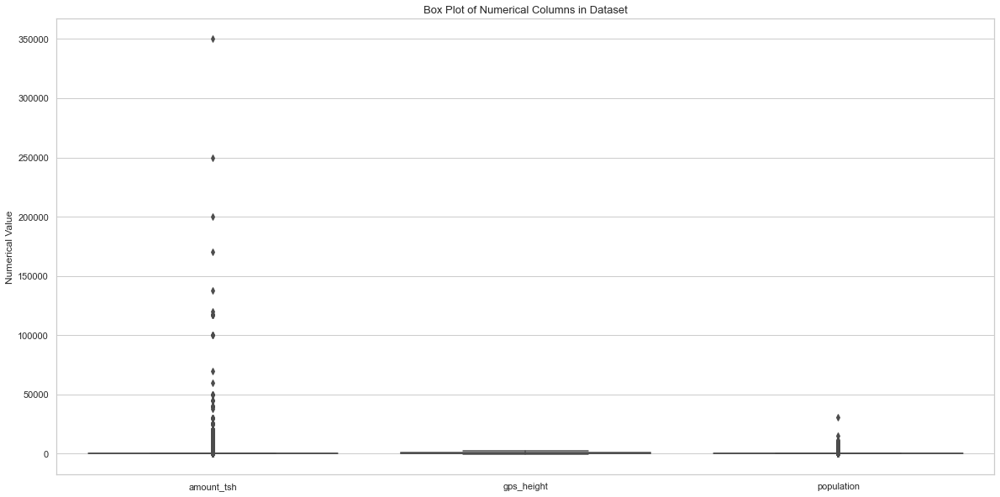

In [100]:
# Plotting box plots of numerical columns
numerical_cols = ['amount_tsh', 'gps_height', 'population']
plt.figure(figsize=(20, 10))
sns.boxplot(data=[Pump_Data_Train[col] for col in numerical_cols])
plt.title("Box Plot of Numerical Columns in Dataset", fontsize=13)
plt.ylabel("Numerical Value")
plt.xticks(range(0,3), numerical_cols)
plt.show()

In [101]:
# Check amount_tsh value counts
Pump_Data_Train['amount_tsh'].value_counts()

0.0         41639
500.0        3102
50.0         2472
1000.0       1488
20.0         1463
            ...  
8500.0          1
6300.0          1
220.0           1
138000.0        1
12.0            1
Name: amount_tsh, Length: 98, dtype: int64

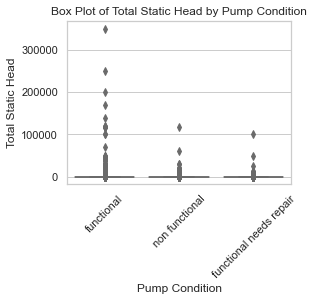

In [102]:
# Plot a box plot of total static head against pump condition
sns.set(style="whitegrid")
plt.figure(figsize=(4, 3))

sns.boxplot(x="status_group", y="amount_tsh", data=Pump_Data_Train, palette="Set3")

plt.title("Box Plot of Total Static Head by Pump Condition")
plt.xlabel("Pump Condition")
plt.ylabel("Total Static Head")
plt.xticks(rotation=45)

plt.show()

The difference between the discharge and suction static heads, or the elevation difference between a well or borehole's outlet, including the pressure head at the outlet, and the inlet, including the pressure head at the inlet, is known as the [total static head](https://www.pumpfundamentals.com/download/book/chapter3.pdf).

I believe that the amount_tsh column contains neither missing values nor outliers for the following reasons.

1. Seasons affect a well's water availability, and I'm not sure if data from some wells was recorded during a time of high rainfall while data from others was recorded during the dry season. 
The units of measurement that were applied to this column are also unknown to me.

2. Non-zero values are showing up as outliers due to the large quantity of zero values. 

[Some wells in the wider Dar es Salaam region can deliver at least 100 liters of water every minute](https://openjicareport.jica.go.jp/pdf/11814811_01.pdf), according to a report by the Japan International Cooperation Agency (JICA), which equates to approximately 144,000 liters per day. As a result, the high 350,000 values might not be unattainable.

4. The pumps with tsh above about 125,000 are all functional, as shown by the box plot of total_static_head vs. functionality labels. Because the higher the tsh, the more likely a pump is to be operational, high static head could be a crucial feature.

For these reasons, I have decided to keep every row in this column exactly as it is.

> Cleaning latitude/longitude columns

In [103]:
# Check unique values in longitude and latitude columns
Pump_Data_Train[['longitude', 'latitude']].value_counts()

longitude  latitude     
0.000000   -2.000000e-08    1812
32.987670  -2.490324e+00       2
37.274352  -7.102004e+00       2
37.534327  -6.964258e+00       2
37.339811  -7.065373e+00       2
                            ... 
36.697381  -2.733935e+00       1
36.697309  -8.092875e+00       1
36.697063  -8.110059e+00       1
36.697013  -3.350101e+00       1
35.004687  -9.265576e+00       1
Length: 57520, dtype: int64

We notice that there 1,812 points with 0 longitude match exactly with -2e-8 latitude, and a Folium map visualization reveals that that location is not in Tanzania.

In [104]:
# Import packages
import folium
from folium.plugins import FloatImage

In [105]:
# Create function to print folium map
def folium_map(data, url):
    # Create 3 dataframes for each status_group
    df_f = Pump_Data_Train[Pump_Data_Train['status_group'] == 'functional']
    df_nf = Pump_Data_Train[Pump_Data_Train['status_group'] == 'non functional']
    df_fnr = Pump_Data_Train[Pump_Data_Train['status_group'] == 'functional needs repair']
    
    # Create lists of latitude and longitude values
    lat_f = [x for x in df_f['latitude']]
    long_f = [x for x in df_f['longitude']]

    lat_nf = [x for x in df_nf['latitude']]
    long_nf = [x for x in df_nf['longitude']]

    lat_fnr = [x for x in df_fnr['latitude']]
    long_fnr = [x for x in df_fnr['longitude']]

    lat_long_f = [(lat_f[i], long_f[i]) for i in range(len(lat_f))]
    lat_long_nf = [(lat_nf[i], long_nf[i]) for i in range(len(lat_nf))]
    lat_long_fnr = [(lat_fnr[i], long_fnr[i]) for i in range(len(lat_fnr))]
    
    # Create map for all locations
    this_map = folium.Map()

    # Loop through 3 dataframes and plot points for each coordinate with labels
    for coord in lat_long_nf[::5]:
        folium.CircleMarker(location=[coord[0], coord[1]], opacity=0.6, color='orange', 
                            radius=1, fill_color='orange', fill_opacity=0.6, 
                            fill=True, tooltip='non functional').add_to(this_map)
    for coord in lat_long_f[::5]:
        folium.CircleMarker(location=[coord[0], coord[1]], opacity=0.6, color='blue', 
                            radius=1, fill_color='blue', fill_opacity=0.6, 
                            fill=True, tooltip='functional').add_to(this_map)
    for coord in lat_long_fnr[::5]:
        folium.CircleMarker(location=[coord[0], coord[1]], opacity=0.6, color='green', 
                            radius=1, fill_color='green', fill_opacity=0.6, 
                            fill=True, tooltip='functional needs repair').add_to(this_map) 

    # Set the zoom to fit our bounds
    this_map.fit_bounds(this_map.get_bounds())

    # Add a custom legend
    legend_html = """
    <div style="position: fixed; 
                 bottom: 50px; left: 50px; width: 200px; height: 100px; 
                 background-color: white;
                 border:2px solid grey; z-index:9999; font-size:14px;
                 ">&nbsp; Legend <br>
                 &nbsp; <i class="fa fa-circle" style="color:orange"></i> Non Functional &nbsp; <br>
                 &nbsp; <i class="fa fa-circle" style="color:blue"></i> Functional &nbsp; <br>
                 &nbsp; <i class="fa fa-circle" style="color:green"></i> Functional Needs Repair &nbsp;
    </div>
    """

    this_map.get_root().html.add_child(folium.Element(legend_html))

    this_map.save(url)
    return this_map

folium_map(Pump_Data_Train, 'images/distribution_of_total_wells_in_tz.html')

In [106]:
# Print percent of zero longitude values
print("Percent of zero longitude entries {:.2%}".format(len(Pump_Data_Train[Pump_Data_Train['longitude'] == 0])/ len(Pump_Data_Train)))

Percent of zero longitude entries 3.05%


The zero longitude values make up only about 3% of the total and therefore, I will delete them from the dataset.

In [107]:
# Drop rows with 0 longitude
Pump_Data_Train = Pump_Data_Train.loc[Pump_Data_Train['longitude'] != 0]

> Transforming of public_meeting and permit columns

In [108]:
# Change the data type of public_meeting and permit columns to binary 
Pump_Data_Train[['public_meeting', 'permit']] = Pump_Data_Train[['public_meeting', 'permit']].astype(int)

In [109]:
# Check info of cleaned dataset
Pump_Data_Train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 57588 entries, 0 to 59399
Data columns (total 21 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   amount_tsh             57588 non-null  float64
 1   gps_height             57588 non-null  int64  
 2   installer              57588 non-null  object 
 3   longitude              57588 non-null  float64
 4   latitude               57588 non-null  float64
 5   basin                  57588 non-null  object 
 6   region                 57588 non-null  object 
 7   lga                    57588 non-null  object 
 8   population             57588 non-null  int64  
 9   public_meeting         57588 non-null  int32  
 10  scheme_management      57588 non-null  object 
 11  permit                 57588 non-null  int32  
 12  extraction_type_class  57588 non-null  object 
 13  management_group       57588 non-null  object 
 14  payment_type           57588 non-null  object 
 15  wa

> 2. **Descriptive Statistics(Visualizatio)**

> Target Feature classes

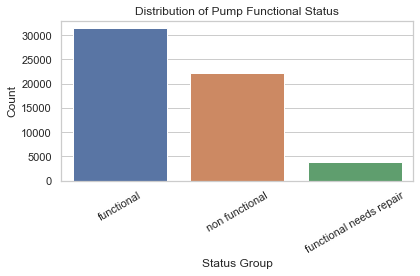

In [110]:
# Plot target class distribution
sns.countplot(data=Pump_Data_Train, x='status_group', order=Pump_Data_Train['status_group'].value_counts().index)
plt.title('Distribution of Pump Functional Status')
plt.xlabel('Status Group')
plt.ylabel('Count')
plt.xticks(rotation=30)
plt.tight_layout()
plt.show()

We notice that the target classes are imbalanced, with the functional pumps being the most common at more than 30,000 followed by non-functional pumps at close to 20,000 pumps, and the lastly the funcational-need-repair pumps at less 5,000.

> Distribution of numerical varibales

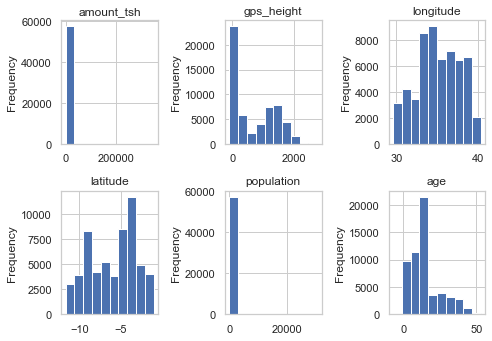

In [111]:
# Histogram of numerical variables
numerical = ['amount_tsh','gps_height','longitude','latitude','population', 'age']
fig = plt.figure(figsize=(7, 7))
for i, col in enumerate(numerical):
    ax = plt.subplot(3, 3, i+1)
    Pump_Data_Train[col].plot(kind='hist', ax=ax, title=col)
plt.tight_layout()
plt.savefig('images/histograms_of_continuous_features.jpg')
plt.show()

> Distribution of categorical variables

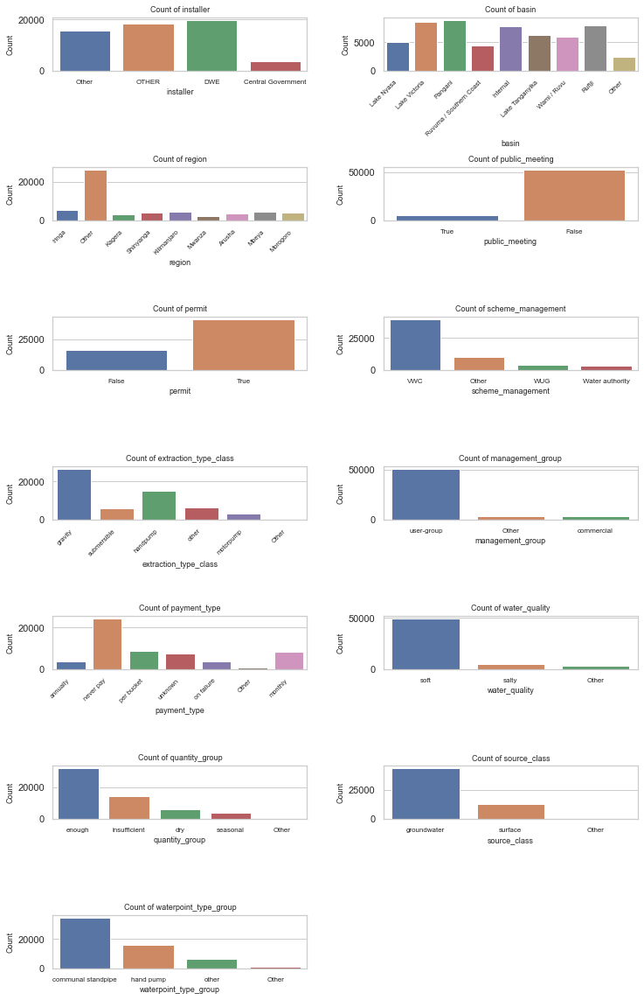

In [112]:
# Set up the subplots with 2 columns and increased spacing
fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(12, 20))
fig.subplots_adjust(hspace=1.8, wspace=0.3)  # Increase hspace and wspace

# Create count bar plots for categorical variables

category = ['installer', 'basin', 'region', 'public_meeting', 'permit', 
           'scheme_management', 'extraction_type_class', 'management_group', 
           'payment_type', 'water_quality', 'quantity_group', 'source_class', 
           'waterpoint_type_group']

for i, column in enumerate(category):
    row, col = i // 2, i % 2
    sns.countplot(data=Pump_Data_Train, x=column, ax=axes[row, col])
    axes[row, col].set_title(f'Count of {column}', fontsize=9)
    axes[row, col].set_xlabel(column, fontsize=9)
    axes[row, col].set_ylabel('Count', fontsize=9)
    
    # Customize x-labels
    x_labels = Pump_Data_Train[column].unique()
    if len(x_labels) > 5:
        axes[row, col].set_xticks(range(len(x_labels))) # Set the positions of the ticks
        axes[row, col].set_xticklabels(x_labels, fontsize=7.5, rotation=45, 
                                       ha='right') # Rotate labels by 45 degrees
    
    elif column in ['public_meeting', 'permit']:
        x_labels_bool = x_labels.astype(bool)
        axes[row, col].set_xticks(range(len(x_labels_bool))) # Set the positions of the ticks
        axes[row, col].set_xticklabels(x_labels_bool, fontsize=8)

    else:
        axes[row, col].set_xticks(range(len(x_labels))) # Set the positions of the ticks
        axes[row, col].set_xticklabels(x_labels, fontsize=8)

# Remove any empty subplots
for i in range(len(category), len(axes.flat)):
    fig.delaxes(axes.flatten()[i])
plt.savefig('images/histograms_of_categorical_features.jpg')
plt.show()

Some classes of categorical features are more frequent/common than others.

> Distribution of target class by categorical feature classes

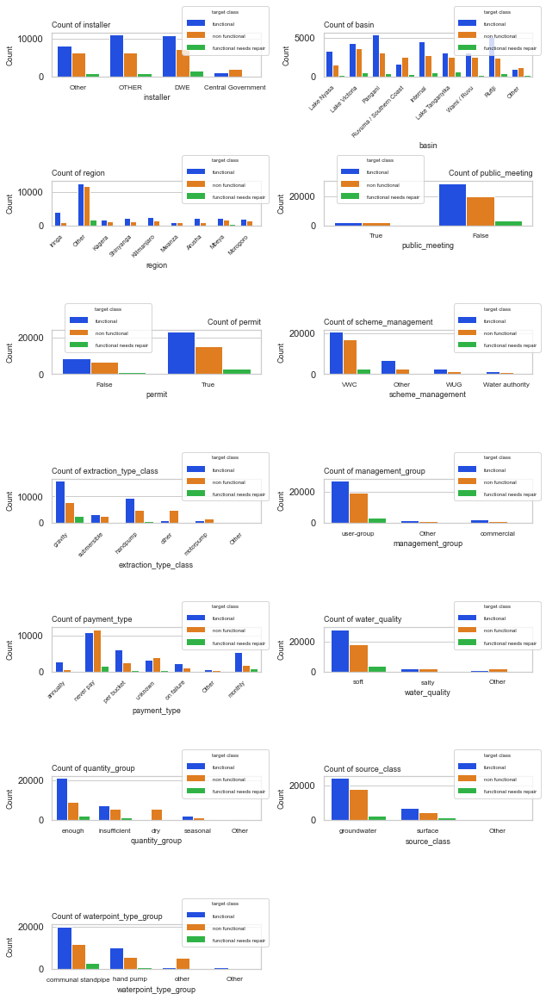

In [113]:
# Set up the subplots with 2 columns and increased spacing
fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(10, 20))
fig.subplots_adjust(hspace=2.35, wspace=0.3)  # Increase hspace and wspace

# Create count bar plots for categorical variables

category = ['installer', 'basin', 'region', 'public_meeting', 'permit', 
           'scheme_management', 'extraction_type_class', 'management_group', 
           'payment_type', 'water_quality', 'quantity_group', 'source_class', 
           'waterpoint_type_group']

for i, column in enumerate(category):
    row, col = i // 2, i % 2
    sns.countplot(x=column, hue='status_group', palette='bright', data=Pump_Data_Train, 
                  ax=axes[row, col])
    axes[row, col].set_xlabel(column, fontsize=9)
    axes[row, col].set_ylabel('Count', fontsize=9)
    
    # Customize x-labels
    x_labels = Pump_Data_Train[column].unique()
    if len(x_labels) > 5:
        axes[row, col].set_title(f'Count of {column}', fontsize=9, loc='left')
        axes[row, col].set_xticks(range(len(x_labels))) # Set the positions of the ticks
        axes[row, col].set_xticklabels(x_labels, fontsize=7, rotation=45, 
                                       ha='right') # Rotate labels by 45 degrees
        # Add legend above each subplot
        legend = axes[row, col].legend(title='target class', title_fontsize=6, 
                                       loc='upper left', bbox_to_anchor=(0.6, 1.7))
        for label in legend.get_texts():
            label.set_fontsize(6)
    
    elif column in ['permit', 'public_meeting']:
        axes[row, col].set_title(f'Count of {column}', fontsize=9, loc='right')
        x_labels_bool = x_labels.astype(bool)
        axes[row, col].set_xticks(range(len(x_labels_bool))) # Set the positions of the ticks
        axes[row, col].set_xticklabels(x_labels_bool, fontsize=8)
        
        # Add legend above each subplot
        legend = axes[row, col].legend(title='target class', title_fontsize=6, 
                                       loc='upper right', bbox_to_anchor=(0.5, 1.7))
        for label in legend.get_texts():
            label.set_fontsize(6)

    else:
        axes[row, col].set_title(f'Count of {column}', fontsize=9, loc='left')
        axes[row, col].set_xticks(range(len(x_labels))) # Set the positions of the ticks
        axes[row, col].set_xticklabels(x_labels, fontsize=8)

        # Add legend above each subplot
        legend = axes[row, col].legend(title='target class', title_fontsize=6, 
                                       loc='upper left', bbox_to_anchor=(0.6, 1.7))
        for label in legend.get_texts():
            label.set_fontsize(6)
            
# Remove any empty subplots
for i in range(len(category), len(axes.flat)):
    fig.delaxes(axes.flatten()[i])
plt.savefig('images/distribution_of_target_class_vs_categorical_features.jpg') #, bbox_inches='tight'
plt.show()

We notice that some classes of the predictor categories have a higher overall count of the target compared to other classes, corresponding to the higher frequency of the respective class.

We also notice that in most of these classes, the functional pumps are more frequent than functional-needs-repair and non-functional pumps. This could be attributed to the fact that there are much more functional pumps than functional-needs-repair and non-functional pumps. 

A notable deviation from this trend is the never-pay class of the payment-type category, where non-functional pumps are more than the other classes of pumps.

>Distribution of target class by continuous features

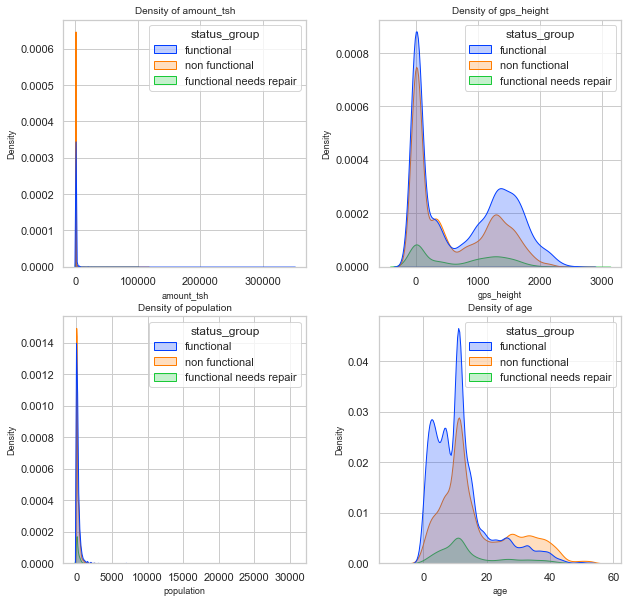

In [114]:
# Set up the subplots with 2 columns and increased spacing
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(10, 10))
fig.subplots_adjust(hspace=0.2, wspace=0.3)  # Increase hspace and wspace

# Create count bar plots for continuous variables
continuous = ['amount_tsh','gps_height',
              'population', 'age']

for i, column in enumerate(continuous):
    row, col = i // 2, i % 2
    sns.kdeplot(data=Pump_Data_Train, x=column, hue='status_group', palette='bright', 
                fill=True, ax=axes[row, col])
    axes[row, col].set_title(f'Density of {column}', fontsize=10)
    axes[row, col].set_xlabel(column, fontsize=9)
    axes[row, col].set_ylabel('Density', fontsize=9)
    
plt.savefig('images/density_of_target_class_vs_continuous_features.jpg')
plt.show()

**Observations:**
1. For the total static head feature (amount_tsh), waterpoints with zero static head have the highest density of pumps overall. Also, among the three pump classes at this point, non-functional pumps have the highest density followed by functional pumps. Functional-needs-repair pumps are the least.
2. For the GPS height feature, functional and non-functional pumps are fairly equal when the GPS height is zero, at which point the functional-needs-repair pumps are much fewer.
3. For the population feature, waterpoints located in areas with zero population have the highest density of pumps overall. Also, among the three pump classes at this point, non-functional pumps have the highest density followed by functional pumps. Functional-needs-repair pumps are the least.
4. For the Age feature, there is a high density of functional pumps. The KDE plot also shows that the density of functional pumps is higher in the range of 0 to 20 while non-functional pumps are higher closer to the age 20 mark going forward to age 40.

>Distribution of pump status class by location

In [115]:
# Recreate Folium map with filtered locations
folium_map(Pump_Data_Train , 'images/distribution_of_filtered_wells_in_tz.html')

From the above, we can observe that:

1. There is a higher density of functional pumps in the Northern regions of Mwanza and Shinyanga, as well as the Southern region of Njombe. 

2. There is a higher density of functional-needs-repair pumps in the Northern regions of Bukoba and Arusha, as well as the Western region of Kigoma.

3. There is a higher density of non-funcational pumps in the Central region of Dodoma, such as the South West region of Mtwara.

### MODELING

> 1. **Data Preprocessing**

The government and other individuals may continue to employ inefficient tools and techniques while drilling wells if working pumps that require repair are not anticipated. This could result in large maintenance costs down the road. 

On the other hand, increasing the false positive rate would also result from decreasing the model's sensitivity in order to accurately anticipate all defective pumps. This would result in the waste of time and money on maintaining pumps that are not faulty.


Correctly classifying every pump will save the government money that is desperately required to construct new water sources. Since the f1-score can only be high when both precision and recall are high, I have decided that it is the optimal performance statistic for this project.

For this project, I will Two models using different classifiers and then compare the performance metrics to choose the best classifier. These will be:
1. Logistic Regression
2. Decision Tree Classifier

> Train-Test Split

I will first split the data into train and test sets. The training set will be 80% of the data and the testing set 20%. 
I will also maintain a random state of 42 to ensure reproducibility.

In [135]:
# Separate features and target
X = Pump_Data_Train.drop('status_group', axis=1)
y = Pump_Data_Train['status_group']

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Identify numerical and categorical columns
num_cols = X.select_dtypes(include=['int64', 'float64']).columns
cat_cols = X.select_dtypes(include=['object']).columns

# Scale numerical features
scaler = StandardScaler()
X_train_num = scaler.fit_transform(X_train[num_cols])
X_test_num = scaler.transform(X_test[num_cols])

# Encode categorical features
encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)
X_train_cat = encoder.fit_transform(X_train[cat_cols])
X_test_cat = encoder.transform(X_test[cat_cols])

# Combine numerical and categorical features
X_train_processed = np.hstack([X_train_num, X_train_cat])
X_test_processed = np.hstack([X_test_num, X_test_cat])

# Get feature names for interpretation
cat_feature_names = encoder.get_feature_names_out(cat_cols)
all_feature_names = np.concatenate([num_cols, cat_feature_names])

c:\Users\JUDAH\Anaconda3\envs\learn-env\lib\site-packages\sklearn\preprocessing\_encoders.py:975: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


In [136]:
Pump_Data_Train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 57588 entries, 0 to 59399
Data columns (total 21 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   amount_tsh             57588 non-null  float64
 1   gps_height             57588 non-null  int64  
 2   installer              57588 non-null  object 
 3   longitude              57588 non-null  float64
 4   latitude               57588 non-null  float64
 5   basin                  57588 non-null  object 
 6   region                 57588 non-null  object 
 7   lga                    57588 non-null  object 
 8   population             57588 non-null  int64  
 9   public_meeting         57588 non-null  int32  
 10  scheme_management      57588 non-null  object 
 11  permit                 57588 non-null  int32  
 12  extraction_type_class  57588 non-null  object 
 13  management_group       57588 non-null  object 
 14  payment_type           57588 non-null  object 
 15  wa

In [137]:
# Initialize OneHotEncoder
ohe = OneHotEncoder(sparse=False, handle_unknown='ignore')  # sparse=False returns array instead of sparse matrix

# Fit and transform categorical columns
X_ohe = ohe.fit_transform(X[cat_col])

# Get feature names
ohe_cols = ohe.get_feature_names_out(cat_col)

# Create DataFrame from encoded data
X_ohe_df = pd.DataFrame(X_ohe, columns=ohe_cols, index=X.index)

# Drop original columns and concatenate
X_final = pd.concat([
    X.drop(columns=cat_col),
    X_ohe_df
], axis=1)

# Print the first 5 rows
print(X_final.head())

c:\Users\JUDAH\Anaconda3\envs\learn-env\lib\site-packages\sklearn\preprocessing\_encoders.py:975: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


   amount_tsh  gps_height  longitude   latitude    lga  population  \
0      6000.0        1390  34.938093  -9.856322  Other         109   
1         0.0        1399  34.698766  -2.147466  Other         280   
2        25.0         686  37.460664  -3.821329  Other         250   
3         0.0         263  38.486161 -11.155298  Other          58   
4         0.0           0  31.130847  -1.825359  Other           0   

   public_meeting  permit   age  installer_Central Government  ...  \
0               1       0  12.0                           0.0  ...   
1               1       1   3.0                           0.0  ...   
2               1       1   4.0                           0.0  ...   
3               1       1  27.0                           0.0  ...   
4               1       1  11.0                           0.0  ...   

   quantity_group_enough  quantity_group_insufficient  \
0                    1.0                          0.0   
1                    0.0                    

In [119]:
# Create a class to print model scores
# Initiate metrics list as a global variable
metrics_list=[]

class Metrics:
    def model_score(self, model, y_true, y_pred):
        # Print classification report, accuracy, precision, recall, f1_score 
        print(classification_report(y_true, y_pred))
        print("Overall accuracy score", accuracy_score(y_true, y_pred))
        print("Overall precision score", precision_score(y_true, y_pred, average='weighted'))
        print("Overall recall score", recall_score(y_true, y_pred, average='weighted'))
        print("Overall F1-score", f1_score(y_true, y_pred, average='weighted'))

        # Print a confusion matrix    
        cnf_matrix = confusion_matrix(y_true, y_pred)
        disp = ConfusionMatrixDisplay(confusion_matrix=cnf_matrix, display_labels=model.classes_)
        print('\nConfusion Matrix')       
        return disp.plot()

    # Create a list of model metrics
    def get_metrics(self, model_name, model, y_true, y_pred):  #y_test, X_test, model
        metrics = {}  
        metrics['model_name'] = model_name
        metrics['accuracy'] = accuracy_score(y_true, y_pred)
        metrics['f1 score'] = f1_score(y_true, y_pred, average='weighted')
        metrics['precision'] = precision_score(y_true, y_pred, average='weighted')
        metrics['recall'] = recall_score(y_true, y_pred, average='weighted')
        metrics_list.append(metrics)
        return metrics_list

> Model Pipeline

In [61]:
# Define a pipeline for baseline logistic regression
pipe_logistic = Pipeline([('ss', StandardScaler()), 
                    ('lr', LogisticRegression(random_state=42))])

# Define a pipeline for baseline decision tree classification
pipe_decision_tree = Pipeline([('ss', StandardScaler()), 
                    ('tree', DecisionTreeClassifier(random_state=42))])


> **Baseline Logistic Regression Model**

To build a simple logistic regression model, I will instantiate the LogisticRegression class and set a high value of C parameter to minimize regularization. I will then fit the model to the training data.

In [139]:
# Fit the logistic regression pipeline to training data
log_model = pipe_logistic.fit(X_train_processed, y_train)

# Print the accuracy on test set
pipe_logistic.score(X_test_processed, y_test)

0.7226080916825838

                         precision    recall  f1-score   support

             functional       0.70      0.90      0.79      6301
functional needs repair       0.20      0.01      0.02       791
         non functional       0.78      0.60      0.68      4426

               accuracy                           0.72     11518
              macro avg       0.56      0.50      0.50     11518
           weighted avg       0.70      0.72      0.69     11518

Overall accuracy score 0.7226080916825838
Overall precision score 0.6967992314509395
Overall recall score 0.7226080916825838
Overall F1-score 0.6926478131478744

Confusion Matrix


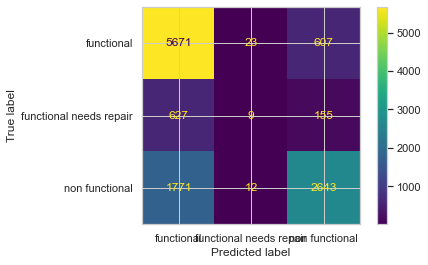

In [140]:
# Print model metrics
# Predict target
y_pred = log_model.predict(X_test_processed)

# Create metrics object
score_metrics = Metrics()

# Print classification report, scores, and confusion matrix
score_metrics.model_score(log_model, y_test, y_pred)

In [160]:
# Create lists of categorical, continuous, and binary columns
cat_col = ['installer', 'basin', 'region', 'scheme_management', 
           'extraction_type_class', 'management_group', 'payment_type', 
           'water_quality', 'quantity_group', 'source_class', 
           'waterpoint_type_group']

cont_col = ['amount_tsh','gps_height','longitude','latitude','population']

binary_col = ['public_meeting', 'permit']

c:\Users\JUDAH\Anaconda3\envs\learn-env\lib\site-packages\sklearn\linear_model\_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
c:\Users\JUDAH\Anaconda3\envs\learn-env\lib\site-packages\matplotlib\text.py:1163: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:


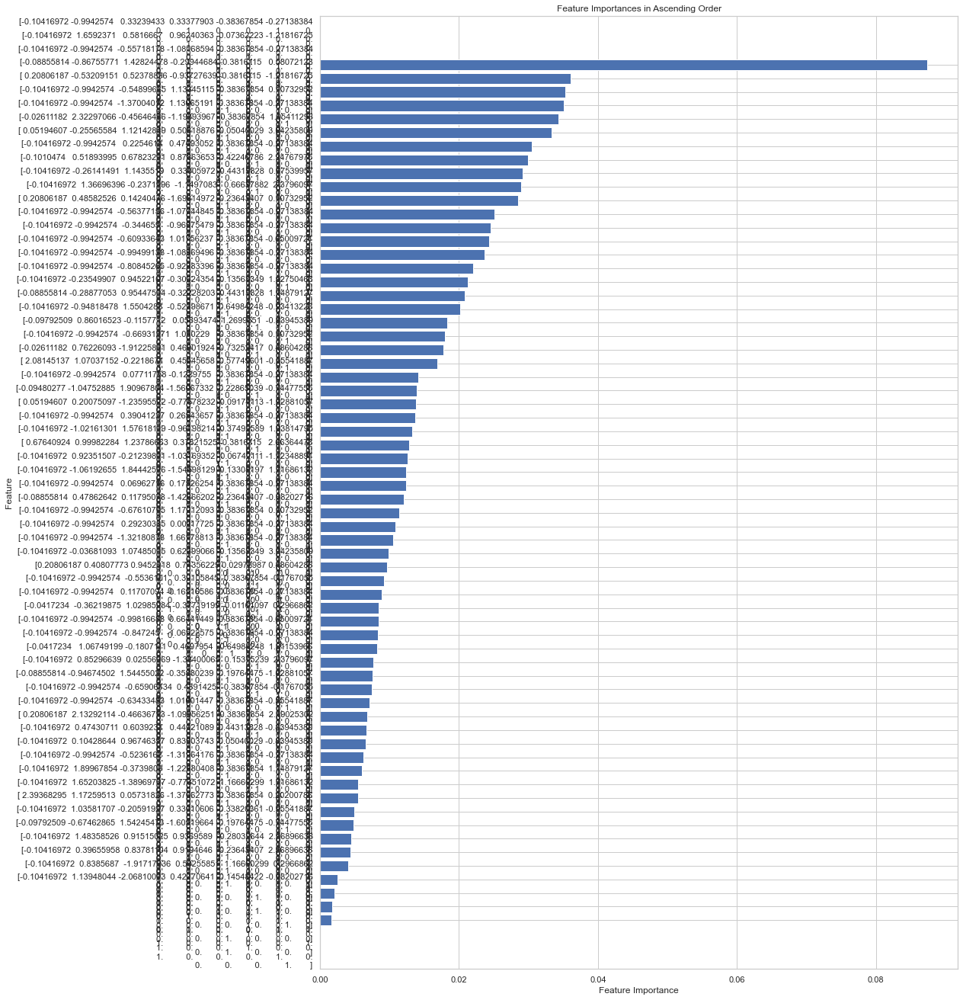

In [161]:
# Plot feature importances for logistic ternary classifier

# Fit a logistic regression model
logistic_model = LogisticRegression()
logistic_model.fit(X_train_processed, y_train)

# Retrieve the coefficients for each feature and class
coefficients = logistic_model.coef_

# Calculate feature importances based on the absolute values of coefficients
importances = np.abs(coefficients)

# Normalize the importances within each class
importances /= np.sum(importances, axis=1)[:, np.newaxis]

# Aggregate importances across classes for an overall importance measure
# Mean importance across classes
overall_importance = np.mean(importances, axis=0)

# Sort and plot feature importances
sorted_indices = overall_importance.argsort()
sorted_feature_names = X_train_processed[sorted_indices]


plt.figure(figsize=(15, 23))
plt.barh(range(len(sorted_indices)), overall_importance[sorted_indices], align='center')
plt.yticks(range(len(sorted_indices)), sorted_feature_names)
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances in Ascending Order')
plt.show()

> **Simple Decision Tree Model**

In [145]:
# Fit the decision tree classifier to training data
dt_model = pipe_decision_tree.fit(X_train_processed, y_train)

# Print the accuracy on test set
pipe_decision_tree.score(X_test_processed, y_test)

0.7478728945997569

                         precision    recall  f1-score   support

             functional       0.80      0.79      0.79      6301
functional needs repair       0.32      0.34      0.33       791
         non functional       0.75      0.76      0.76      4426

               accuracy                           0.75     11518
              macro avg       0.63      0.63      0.63     11518
           weighted avg       0.75      0.75      0.75     11518

Overall accuracy score 0.7478728945997569
Overall precision score 0.7492831548955652
Overall recall score 0.7478728945997569
Overall F1-score 0.7485478819922312

Confusion Matrix


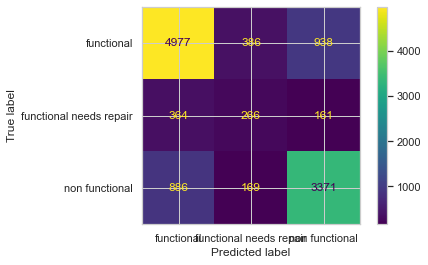

In [146]:
# Print model metrics
# Predict target
y_pred = dt_model.predict(X_test_processed)

# Create metrics object
score_metrics = Metrics()

# Print classification report, scores, and confusion matrix
score_metrics.model_score(dt_model, y_test, y_pred)

In [158]:
# Create lists of categorical, continuous, and binary columns
cat_col = ['installer', 'basin', 'region', 'scheme_management', 
           'extraction_type_class', 'management_group', 'payment_type', 
           'water_quality', 'quantity_group', 'source_class', 
           'waterpoint_type_group']

cont_col = ['amount_tsh','gps_height','longitude','latitude','population']

binary_col = ['public_meeting', 'permit']

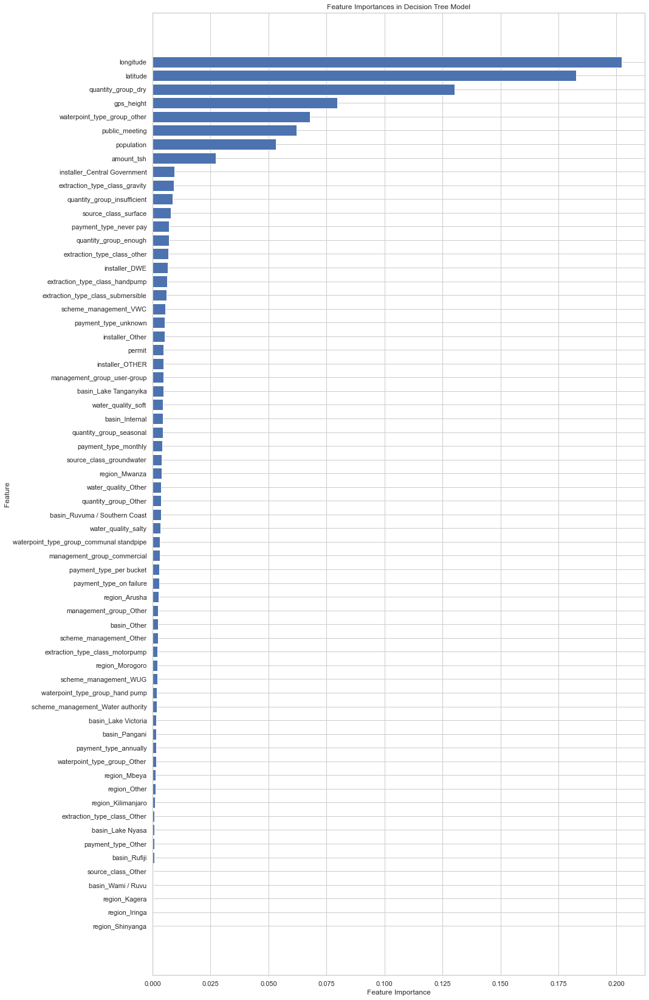

In [159]:
# Feature importance plot for decision tree classifier

# Fit the decision tree classifier to training data
dt_model_f = pipe_decision_tree.named_steps['tree'].fit(X_train_processed, y_train)

# Get feature importances from the decision tree
feature_importances = dt_model_f.feature_importances_

# First: Recreate your processed training DataFrame exactly as you did before modeling
X_cat_dummies = pd.get_dummies(X[cat_col], drop_first=False)  # or True if you used that

# Now concatenate everything in the correct order
X_full = pd.concat([X[cont_col], X[binary_col], X_cat_dummies], axis=1)

# Store feature names from this processed DataFrame
feature_names = X_full.columns.tolist()

# Now double-check length match
if len(feature_names) != X_train_processed.shape[1]:
    print(f"Mismatch: {len(feature_names)} names vs {X_train_processed.shape[1]} features")
else:
    # Safe to plot
    sorted_indices = feature_importances.argsort()
    sorted_feature_names = [feature_names[i] for i in sorted_indices]

    plt.figure(figsize=(15, 23))
    plt.barh(range(len(feature_importances)), feature_importances[sorted_indices], align='center')
    plt.yticks(range(len(feature_importances)), sorted_feature_names)
    plt.xlabel('Feature Importance')
    plt.ylabel('Feature')
    plt.title('Feature Importances in Decision Tree Model')
    plt.tight_layout()
    plt.show()


From the 2 baseline models, we can observe that the Decision Trees classifier has the highest accuracy score of about 0.74 and also the highest f1-score of about 0.749.

The plots of features importances show that the 10 most influential features are:<br>
i.) Longitude<br>
ii.) Latitude<br>
iii.) Quantity_group<br>
iv.) gps height<br>
v.) Population<br>
vi.) Water type group<br>
vii.) Contruction year<br>
viii.) Payment type or method<br>
ix.) Extraction type class<br>
x.) amount_tsh

### Evaluation

In [162]:
# === Logistic Regression ===
print("=== Baseline Logistic Regression ===")
y_pred_log = logistic_model.predict(X_test_processed)

print(classification_report(y_test, y_pred_log))
print("Overall accuracy score:", accuracy_score(y_test, y_pred_log))
print("Overall precision score:", precision_score(y_test, y_pred_log, average='weighted'))
print("Overall recall score:", recall_score(y_test, y_pred_log, average='weighted'))
print("Overall F1-score:", f1_score(y_test, y_pred_log, average='weighted'))

# === Simple Decision Tree ===
print("\n=== Simple Decision Tree ===")
y_pred_tree = dt_model.predict(X_test_processed)

print(classification_report(y_test, y_pred_tree))
print("Overall accuracy score:", accuracy_score(y_test, y_pred_tree))
print("Overall precision score:", precision_score(y_test, y_pred_tree, average='weighted'))
print("Overall recall score:", recall_score(y_test, y_pred_tree, average='weighted'))
print("Overall F1-score:", f1_score(y_test, y_pred_tree, average='weighted'))


=== Baseline Logistic Regression ===
                         precision    recall  f1-score   support

             functional       0.70      0.90      0.79      6301
functional needs repair       0.21      0.01      0.02       791
         non functional       0.78      0.60      0.67      4426

               accuracy                           0.72     11518
              macro avg       0.56      0.50      0.49     11518
           weighted avg       0.70      0.72      0.69     11518

Overall accuracy score: 0.7221739885396771
Overall precision score: 0.6965400944059335
Overall recall score: 0.7221739885396771
Overall F1-score: 0.6922235037666704

=== Simple Decision Tree ===
                         precision    recall  f1-score   support

             functional       0.77      0.76      0.76      6301
functional needs repair       0.30      0.33      0.32       791
         non functional       0.72      0.72      0.72      4426

               accuracy                         

### Conclusion

 . We compared two models — a baseline logistic regression and a simple decision tree classifier — for predicting the functional status of water pumps. The results are as follows:

 **Logistic Regression**

 > Accuracy: 72.26%

 > F1-score (weighted): 69.26%

 . Performs very well on the majority class (functional), but fails on the minority class (functional needs repair) with a recall of just 1%.

 . Indicates strong class imbalance sensitivity.

 **Simple Decision Tree**

 > Accuracy: 74.79%

 > F1-score (weighted): 74.85%

 . Shows balanced performance across all classes.

 . Significant improvement in recall for the minority class (functional needs repair: recall increased to 34%).

### Next Steps 

 . The simple decision tree model outperforms the logistic regression baseline in almost all evaluation metrics. Notably, it handles the minority class better, making it more suitable for real-world deployment where catching under-repaired water points is crucial.